<a href="https://colab.research.google.com/github/reshmanair01/Dissertation/blob/main/SarcasmIronytwitter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Load Modules -

In [ ]:
!pip install transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 23.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 29.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 88.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 78.7 MB/s eta 0:00:00


In [ ]:
!pip install umap-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 2.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 14.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82808 sha256=db5ffccd6c2287a131d3fad255c834bf815976a1a3133f1a07c181ebc018d9c7
  Stored in directory: /root/.cache/pip/wheels/a0/e8/c6/a37ea663620bd5200ea1ba0907ab3c217042c1d035ef606acc
  Created wheel for pynndescent: filename=pynndescent-0.5.10-py3-none-any.whl size=55617 sha256=b89fdc4adf60e2b11cbd83e5b7c2510df949350df55009ee79d72dcaaab24470
  Stored in directory: /root/.cache/pip/wheels/4a/38/5d/f60a40a66a9512b7e5e83517ebc2d1b42d857be97d135f1096
Successfully built umap-learn pynndescent


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf

# Sarcasam Dataset PreProcessing - Initial

In [ ]:
# Define a function to load and extract the required column from the given file
def extract_text_column(file_path, class_name):
    with open(file_path, 'r', encoding='utf-8') as file:
        first_line = file.readline()

    # Infer the delimiter based on the first line
    delimiters = [',', ';', '\t', '|']
    delimiter_counts = {delim: first_line.count(delim) for delim in delimiters}
    most_common_delim = max(delimiter_counts, key=delimiter_counts.get)

    df = pd.read_csv(file_path, delimiter=most_common_delim)

    # Assuming the tweet text is in the 5th column (0-based index)
    df = df.iloc[:, 4:5]
    df.columns = ["text"]
    df["class"] = class_name

    return df

In [ ]:
data_files = ['sarcasm.csv',
 'irony_test.csv',
 '.DS_Store',
 'readme.txt',
 'regular_test.csv',
 'irony.csv',
 'figurative.csv',
 'sarcasm_test.csv',
 'figurative_test.csv',
 'regular.csv']

In [ ]:
# Filter out non-CSV files and those not ending with "_test.csv"
relevant_files = [f for f in data_files if f.endswith(".csv") and not f.endswith("_test.csv")]

# Extract and merge data from each file
merged_df = pd.concat([extract_text_column(f"{file_name}", file_name.split(".")[0])
                       for file_name in relevant_files], ignore_index=True)
merged_df.head()

In [ ]:
merged_df.to_csv("tweet_sarcasm.csv")

# Load the datasets -

In [ ]:
product_data = pd.read_csv('product_company_tweet.csv', encoding='ISO-8859-1')
sarcasm_data = pd.read_csv('tweet_sarcasm.csv')

In [ ]:
product_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9093 entries, 0 to 9092
Data columns (total 3 columns):
 #   Column                                              Non-Null Count  Dtype 
---  ------                                              --------------  ----- 
 0   tweet_text                                          9092 non-null   object
 1   emotion_in_tweet_is_directed_at                     3291 non-null   object
 2   is_there_an_emotion_directed_at_a_brand_or_product  9093 non-null   object
dtypes: object(3)
memory usage: 213.2+ KB


In [ ]:
product_data.head(2)

,tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product
0,.@wesley83 I have a 3G iPhone. After 3 hrs twe...,iPhone,Negative emotion
1,@jessedee Know about @fludapp ? Awesome iPad/i...,iPad or iPhone App,Positive emotion


In [ ]:
sarcasm_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81408 entries, 0 to 81407
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   tweets  81408 non-null  object
 1   class   81408 non-null  object
dtypes: object(2)
memory usage: 1.2+ MB


In [ ]:
sarcasm_data.head(2)

,tweets,class
0,Be aware dirty step to get money #staylight ...,figurative
1,#sarcasm for #people who don't understand #diy...,figurative


# Pre-Processing -

In [ ]:
# Add a new column to each dataframe to specify the context
product_data['context'] = 'product'
sarcasm_data['context'] = 'general'

In [ ]:
product_data.head(2)

,tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product,context
0,.@wesley83 I have a 3G iPhone. After 3 hrs twe...,iPhone,Negative emotion,product
1,@jessedee Know about @fludapp ? Awesome iPad/i...,iPad or iPhone App,Positive emotion,product


In [ ]:
# Merge the two dataframes
merged_data = pd.concat([product_data, sarcasm_data])

In [ ]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90501 entries, 0 to 81407
Data columns (total 6 columns):
 #   Column                                              Non-Null Count  Dtype 
---  ------                                              --------------  ----- 
 0   tweet_text                                          9092 non-null   object
 1   emotion_in_tweet_is_directed_at                     3291 non-null   object
 2   is_there_an_emotion_directed_at_a_brand_or_product  9093 non-null   object
 3   context                                             90501 non-null  object
 4   tweets                                              81408 non-null  object
 5   class                                               81408 non-null  object
dtypes: object(6)
memory usage: 4.8+ MB


In [ ]:
merged_data.head(5)

,tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product,context,tweets,class
0,.@wesley83 I have a 3G iPhone. After 3 hrs twe...,iPhone,Negative emotion,product,NaN,NaN
1,@jessedee Know about @fludapp ? Awesome iPad/i...,iPad or iPhone App,Positive emotion,product,NaN,NaN
2,@swonderlin Can not wait for #iPad 2 also. The...,iPad,Positive emotion,product,NaN,NaN
3,@sxsw I hope this year's festival isn't as cra...,iPad or iPhone App,Negative emotion,product,NaN,NaN
4,@sxtxstate great stuff on Fri #SXSW: Marissa M...,Google,Positive emotion,product,NaN,NaN


In [ ]:
# Merge the two dataframes
merged_data = pd.concat([product_data, sarcasm_data])

# Fill missing values with empty strings
merged_data['tweet_text'].fillna('', inplace=True)
merged_data['tweets'].fillna('', inplace=True)

# Generate the 'all_text' column
merged_data['all_text'] = merged_data['tweet_text'] + ' ' + merged_data['tweets']

# Make sure to shuffle your data if needed
merged_data = merged_data.sample(frac=1).reset_index(drop=True)

In [ ]:
merged_data.head(5)

,tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product,context,tweets,class,all_text
0,,NaN,NaN,general,"Be informed, inspired into action, starting w...",regular,"Be informed, inspired into action, starting ..."
1,,NaN,NaN,general,"Ops, mother and daughter died. Damn, that's se...",sarcasm,"Ops, mother and daughter died. Damn, that's s..."
2,,NaN,NaN,general,Guilty as soon as accused sounds bout rite #sa...,sarcasm,Guilty as soon as accused sounds bout rite #s...
3,,NaN,NaN,general,"The Weeknd has so much talent, but raps about ...",regular,"The Weeknd has so much talent, but raps about..."
4,,NaN,NaN,general,"View of the Ebro from Briñas, Rioja. Don't kno...",irony,"View of the Ebro from Briñas, Rioja. Don't kn..."


In [ ]:
# checking null values in all_text because it is having all tweets from product and sarcasm dataset
merged_data['all_text'].isna().sum()

0

In [ ]:
merged_data['is_there_an_emotion_directed_at_a_brand_or_product'].unique()

array([nan, 'Negative emotion', 'Positive emotion',
       'No emotion toward brand or product', "I can't tell"], dtype=object)

In [ ]:
merged_data['class'].unique()

array(['regular', 'sarcasm', 'irony', nan, 'figurative'], dtype=object)

In [ ]:
num_nan = merged_data['class'].isna().sum()
print(f"There are {num_nan} 'nan' values in the 'class' column.")

There are 9093 'nan' values in the 'class' column.


In [ ]:
nan_rows = merged_data[merged_data['class'].isna()]
print(nan_rows)

                                              tweet_text  \
5      iPhone GPS is messed up. Thinks I'm in Yonkers...   
9      @mention Just started using the Android app. T...   
11     Settling into first #SXSW session: #battledeck...   
14        Google maps for mobile 5.2 looks awesome.#sxsw   
24     ÛÏ@mention Are you Stupid? Find it out at the...   
...                                                  ...   
90418  HootSuite Mobile for #SXSW ~ Updates for iPhon...   
90455  Google Circles launching today at #SXSW? New #...   
90456  ÛÏ@mention Google set to launch new social ne...   
90467  Checking out Poked, Liked &amp; Re-Tweeted: A ...   
90469  Enjoying a Google ice cream sandwich at the GS...   

       emotion_in_tweet_is_directed_at  \
5                               iPhone   
9                          Android App   
11                  iPad or iPhone App   
14     Other Google product or service   
24                                 NaN   
...                        

In [ ]:
regular_rows = merged_data[merged_data['class'] == 'regular']
print(regular_rows) ## Filling regular on all the classes with nan values because all are related to product category

      tweet_text emotion_in_tweet_is_directed_at  \
0                                            NaN   
3                                            NaN   
12                                           NaN   
16                                           NaN   
17                                           NaN   
...          ...                             ...   
90490                                        NaN   
90491                                        NaN   
90492                                        NaN   
90495                                        NaN   
90497                                        NaN   

      is_there_an_emotion_directed_at_a_brand_or_product  context  \
0                                                    NaN  general   
3                                                    NaN  general   
12                                                   NaN  general   
16                                                   NaN  general   
17                            

## Data Cleaning

In [ ]:
import re

In [ ]:
# Based on the above result fro column 'is_there_an_emotion_directed_at_a_brand_or_product'
# replacing {'nan','I can't tell'} with 'No emotion toward brand or product'

# Fill 'nan' values with 'No emotion toward brand or product'
merged_data['is_there_an_emotion_directed_at_a_brand_or_product'].fillna('No emotion toward brand or product', inplace=True)

# Replace "I can't tell" values with 'No emotion toward brand or product'
merged_data['is_there_an_emotion_directed_at_a_brand_or_product'].replace("I can't tell", 'No emotion toward brand or product', inplace=True)

In [ ]:
## Filling regular on all the classes with nan values because all are related to product category
# Replace 'nan' values with 'regular'
merged_data['class'].fillna('regular', inplace=True)

In [ ]:
# Function to remove URLs
def remove_urls(text):
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    return url_pattern.sub(r'', text)

# Apply the function to your text data
merged_data['all_text'] = merged_data['all_text'].apply(remove_urls)

In [ ]:
import re

# Function to remove hashtags
def remove_hashtags(text):
    return re.sub(r'#\w+', '', text)

# Apply the function to your text data
merged_data['all_text'] = merged_data['all_text'].apply(remove_hashtags)

In [ ]:
merged_data.head(5)

,tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product,context,tweets,class,all_text
0,,NaN,No emotion toward brand or product,general,"Be informed, inspired into action, starting w...",regular,"Be informed, inspired into action, starting ..."
1,,NaN,No emotion toward brand or product,general,"Ops, mother and daughter died. Damn, that's se...",sarcasm,"Ops, mother and daughter died. Damn, that's s..."
2,,NaN,No emotion toward brand or product,general,Guilty as soon as accused sounds bout rite #sa...,sarcasm,Guilty as soon as accused sounds bout rite
3,,NaN,No emotion toward brand or product,general,"The Weeknd has so much talent, but raps about ...",regular,"The Weeknd has so much talent, but raps about..."
4,,NaN,No emotion toward brand or product,general,"View of the Ebro from Briñas, Rioja. Don't kno...",irony,"View of the Ebro from Briñas, Rioja. Don't kn..."


# EDA

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

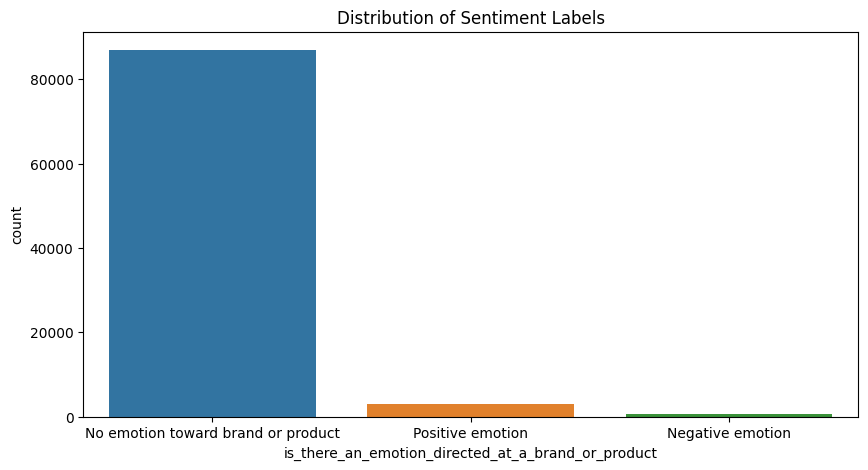

In [ ]:
# Plot for sentiment labels
plt.figure(figsize=(10, 5))
sns.countplot(data=merged_data, x='is_there_an_emotion_directed_at_a_brand_or_product')
plt.title('Distribution of Sentiment Labels')
plt.show()

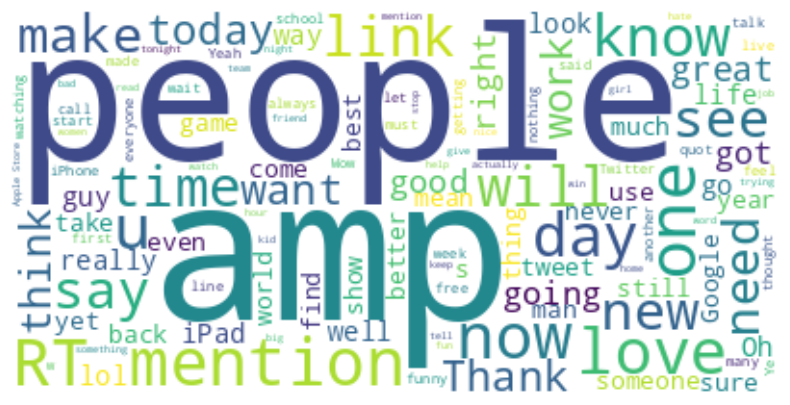

In [ ]:
## Checking the most common words list
# Combine all text into one big text
text = ' '.join(text for text in merged_data['all_text'])

# Create a word cloud
wordcloud = WordCloud(background_color='white').generate(text)

# Display the word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [ ]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90501 entries, 0 to 90500
Data columns (total 7 columns):
 #   Column                                              Non-Null Count  Dtype 
---  ------                                              --------------  ----- 
 0   tweet_text                                          90501 non-null  object
 1   emotion_in_tweet_is_directed_at                     3291 non-null   object
 2   is_there_an_emotion_directed_at_a_brand_or_product  90501 non-null  object
 3   context                                             90501 non-null  object
 4   tweets                                              90501 non-null  object
 5   class                                               90501 non-null  object
 6   all_text                                            90501 non-null  object
dtypes: object(7)
memory usage: 4.8+ MB


# Preparing data for modeling -

### Text Normalization

In [ ]:
# Convert to lowercase
merged_data['all_text'] = merged_data['all_text'].str.lower()

# Remove punctuation
merged_data['all_text'] = merged_data['all_text'].str.replace('[^\w\s]','')

<ipython-input-28-94e8907f5e54>:5: FutureWarning: The default value of regex will change from True to False in a future version.
  merged_data['all_text'] = merged_data['all_text'].str.replace('[^\w\s]','')


# Model

In [ ]:
!pip install transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 28.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 30.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 77.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 73.0 MB/s eta 0:00:00


In [ ]:
import tensorflow as tf
from transformers import BertTokenizer, TFBertModel
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

In [ ]:
from transformers import BertTokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from transformers import MobileBertTokenizer

tokenizer = MobileBertTokenizer.from_pretrained('google/mobilebert-uncased')

In [ ]:
# Tokenize the text and create input IDs
input_ids = [tokenizer.encode(text, add_special_tokens=True, max_length=512, truncation=True) for text in merged_data['all_text']]

In [ ]:
# Create attention masks
attention_masks = [[1] * len(input_id) for input_id in input_ids]

In [ ]:
# Pad the sequences
input_ids = pad_sequences(input_ids, maxlen=512, dtype='int32', padding='post', truncating='post', value=0)
attention_masks = pad_sequences(attention_masks, maxlen=512, dtype='int32', padding='post', truncating='post', value=0)

In [ ]:
print("Shape of input_ids:", input_ids.shape)
print("Shape of attention_masks:", attention_masks.shape)

Shape of input_ids: (90501, 512)
Shape of attention_masks: (90501, 512)


In [ ]:
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

# Create a label encoder for 'context'
le_context = LabelEncoder()
context_encoded = le_context.fit_transform(merged_data['context'])

# Create a label encoder for 'class'
le_class = LabelEncoder()
class_encoded = le_class.fit_transform(merged_data['class'])

In [ ]:
from sklearn.model_selection import train_test_split

# Assuming `context_encoded` and `class_encoded` are your encoded labels
labels = list(zip(context_encoded, class_encoded))

# Split the data into training and validation sets
train_inputs, validation_inputs, train_labels, validation_labels = train_test_split(input_ids, labels, random_state=42, test_size=0.1)
train_masks, validation_masks, _, _ = train_test_split(attention_masks, input_ids, random_state=42, test_size=0.1)

# Separate the context and class labels
train_context, train_class = zip(*train_labels)
validation_context, validation_class = zip(*validation_labels)

In [ ]:
from transformers import TFMobileBertModel
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dropout, Dense, Bidirectional, LSTM
from tensorflow.keras.optimizers.schedules import ExponentialDecay
from tensorflow.keras.optimizers import Adam

# Define the inputs
input_ids = Input(shape=(512,), dtype='int32')
attention_masks = Input(shape=(512,), dtype='int32')

# Load the MobileBERT model
bert_model = TFMobileBertModel.from_pretrained('google/mobilebert-uncased')

# Pass the inputs through the BERT model
bert_output = bert_model([input_ids, attention_masks])[0]

# Add a BiLSTM layer
lstm_output = Bidirectional(LSTM(128, return_sequences=False))(bert_output)

# Add dropout for regularization
lstm_output = Dropout(0.1)(lstm_output)

# Add a Dense layer for each classification task
context_output = Dense(len(le_context.classes_), activation='softmax', name='context_output')(lstm_output)
class_output = Dense(len(le_class.classes_), activation='softmax', name='class_output')(lstm_output)

# Define the model
model = Model(inputs=[input_ids, attention_masks], outputs=[context_output, class_output])

from transformers import AdamWeightDecay, get_cosine_schedule_with_warmup

# Set up the learning rate schedule
initial_learning_rate = 2e-5
decay_steps = 10000
decay_rate = 0.96
lr_schedule = ExponentialDecay(
    initial_learning_rate,
    decay_steps=decay_steps,
    decay_rate=decay_rate,
    staircase=True)

# Initialize the Adam optimizer with learning rate schedule
optimizer = Adam(learning_rate=lr_schedule)

from tensorflow.keras.callbacks import ModelCheckpoint

# Create a callback that saves the model's weights
checkpoint = ModelCheckpoint(filepath="/content/drive/My Drive/checkpoint.ckpt",
                             save_weights_only=True,
                             save_best_only=True,
                             monitor='val_loss',
                             verbose=1)


# Compile the model
model.compile(
    optimizer=optimizer,
    loss={'context_output': 'sparse_categorical_crossentropy', 'class_output': 'sparse_categorical_crossentropy'},
    metrics={'context_output': 'accuracy', 'class_output': 'accuracy'}
)

Some layers from the model checkpoint at google/mobilebert-uncased were not used when initializing TFMobileBertModel: ['seq_relationship___cls', 'predictions___cls']
- This IS expected if you are initializing TFMobileBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFMobileBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFMobileBertModel were initialized from the model checkpoint at google/mobilebert-uncased.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFMobileBertModel for predictions without further training.


In [ ]:
# Display the model architecture
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512)]        0           []                               
                                                                                                  
 input_2 (InputLayer)           [(None, 512)]        0           []                               
                                                                                                  
 tf_mobile_bert_model (TFMobile  TFBaseModelOutputWi  24581888   ['input_1[0][0]',                
 BertModel)                     thPooling(last_hidd               'input_2[0][0]']                
                                en_state=(None, 512                                               
                                , 512),                                                       

In [ ]:
from google.colab import drive


In [ ]:
# Convert the targets to numpy arrays
train_context = np.array(train_context)
validation_context = np.array(validation_context)
train_class = np.array(train_class)
validation_class = np.array(validation_class)

history = model.fit(
    [train_inputs, train_masks],
    [train_context, train_class],
    validation_data=([validation_inputs, validation_masks], [validation_context, validation_class]),
    batch_size=20,
    epochs=10, callbacks=[checkpoint]
)

Epoch 1/3
4073/4073 [==============================] - ETA: 0s - loss: 1.1883 - context_output_loss: 0.0632 - class_output_loss: 1.1251 - context_output_accuracy: 0.9812 - class_output_accuracy: 0.4782
Epoch 1: val_loss improved from inf to 1.05903, saving model to /content/drive/My Drive/checkpoint.ckpt
4073/4073 [==============================] - 5158s 1s/step - loss: 1.1883 - context_output_loss: 0.0632 - class_output_loss: 1.1251 - context_output_accuracy: 0.9812 - class_output_accuracy: 0.4782 - val_loss: 1.0590 - val_context_output_loss: 0.0312 - val_class_output_loss: 1.0279 - val_context_output_accuracy: 0.9918 - val_class_output_accuracy: 0.5414
Epoch 2/3
4073/4073 [==============================] - ETA: 0s - loss: 1.0348 - context_output_loss: 0.0282 - class_output_loss: 1.0067 - context_output_accuracy: 0.9917 - class_output_accuracy: 0.5416
Epoch 2: val_loss improved from 1.05903 to 1.00255, saving model to /content/drive/My Drive/checkpoint.ckpt
4073/4073 [================

In [ ]:
model.save('/content/drive/My Drive/twitter_multiclass_model.h5')

In [ ]:
# Load the checkpoint weights
model.load_weights('/content/drive/My Drive/checkpoint.ckpt')

In [ ]:
# Convert the targets to numpy arrays
train_context = np.array(train_context)
validation_context = np.array(validation_context)
train_class = np.array(train_class)
validation_class = np.array(validation_class)

In [ ]:
# Continue training for 4 more epochs (total 7 epochs)
history = model.fit(
    [train_inputs, train_masks],
    [train_context, train_class],
    validation_data=([validation_inputs, validation_masks], [validation_context, validation_class]),
    batch_size=20,
    epochs=7,  # Train for 4 more epochs (total 7 epochs)
    callbacks=[checkpoint]  # Assuming you have defined the checkpoint callback
)

Epoch 1/7
4073/4073 [==============================] - ETA: 0s - loss: 0.9260 - context_output_loss: 0.0200 - class_output_loss: 0.9060 - context_output_accuracy: 0.9941 - class_output_accuracy: 0.5890
Epoch 1: val_loss improved from inf to 0.89691, saving model to /content/drive/My Drive/checkpoint.ckpt
4073/4073 [==============================] - 5326s 1s/step - loss: 0.9260 - context_output_loss: 0.0200 - class_output_loss: 0.9060 - context_output_accuracy: 0.9941 - class_output_accuracy: 0.5890 - val_loss: 0.8969 - val_context_output_loss: 0.0206 - val_class_output_loss: 0.8763 - val_context_output_accuracy: 0.9931 - val_class_output_accuracy: 0.6053
Epoch 2/7
4073/4073 [==============================] - ETA: 0s - loss: 0.8692 - context_output_loss: 0.0153 - class_output_loss: 0.8538 - context_output_accuracy: 0.9956 - class_output_accuracy: 0.6114
Epoch 2: val_loss improved from 0.89691 to 0.89197, saving model to /content/drive/My Drive/checkpoint.ckpt
4073/4073 [================

# Model Valdation

In [ ]:
!pip install transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 61.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 27.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 96.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 81.2 MB/s eta 0:00:00


Run load and preprocessing - modules above

In [ ]:
from tensorflow.keras.models import load_model
from transformers import MobileBertTokenizer
from transformers import TFMobileBertModel
from sklearn.preprocessing import LabelEncoder

model = load_model('/content/drive/My Drive/twitter_multiclass_model (1).h5',
                   custom_objects={'TFMobileBertModel': TFMobileBertModel})

# Load the tokenizer
tokenizer = MobileBertTokenizer.from_pretrained('google/mobilebert-uncased')

In [ ]:
# Sample text
texts = ['I dont think any TV show could be more #Epic than #MasterShowman! This show is the bees knees!!']

# Preprocess the text
inputs = tokenizer(texts, return_tensors='tf', padding='max_length', truncation=True, max_length=512)

# Get the input IDs and attention masks
input_ids = inputs['input_ids']
attention_masks = inputs['attention_mask']

# Make predictions
predictions = model.predict([input_ids, attention_masks])

# The model returns probabilities for each class. To get the actual classes, we can use the argmax function.
context_predictions = np.argmax(predictions[0], axis=1)
class_predictions = np.argmax(predictions[1], axis=1)

# Create the encoders
le_context = LabelEncoder()
le_class = LabelEncoder()

# Fit the encoders
le_context.fit(merged_data['context'])
le_class.fit(merged_data['class'])

# Convert the indices back to their original labels
context_labels = le_context.inverse_transform(context_predictions)
class_labels = le_class.inverse_transform(class_predictions)

print("Context Predictions:", context_labels)
print("Class Predictions:", class_labels)

1/1 [==============================] - 22s 22s/step
Context Predictions: ['general']
Class Predictions: ['sarcasm']


# Analysis

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import load_model
from transformers import MobileBertTokenizer
from transformers import TFMobileBertModel
import pandas as pd
from tensorflow.keras.models import Model
from tensorflow.keras.models import load_model
from transformers import MobileBertTokenizer
from transformers import TFMobileBertModel
from sklearn.preprocessing import LabelEncoder
from sklearn.manifold import TSNE
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import umap

In [ ]:
model = load_model('/content/drive/My Drive/twitter_multiclass_model (1).h5',
                   custom_objects={'TFMobileBertModel': TFMobileBertModel})

# Load the tokenizer
tokenizer = MobileBertTokenizer.from_pretrained('google/mobilebert-uncased')

In [ ]:
from tensorflow.keras.models import Model
import numpy as np

# Create a new model to extract word-level embeddings
word_embedding_layer = model.get_layer(name='bidirectional').output
word_embedding_model = Model(inputs=model.input, outputs=word_embedding_layer)

# Sample a subset of the data
subset_size = 1000
subset = merged_data.sample(subset_size)

# Tokenize and preprocess the subset
input_ids_subset = [tokenizer.encode(text, add_special_tokens=True, max_length=512, truncation=True) for text in subset['all_text']]
attention_masks_subset = [[1] * len(input_id) for input_id in input_ids_subset]
input_ids_subset = pad_sequences(input_ids_subset, maxlen=512, dtype='int32', padding='post', truncating='post', value=0)
attention_masks_subset = pad_sequences(attention_masks_subset, maxlen=512, dtype='int32', padding='post', truncating='post', value=0)

# Convert input data to TensorFlow tensors
input_ids_subset = tf.constant(input_ids_subset)
attention_masks_subset = tf.constant(attention_masks_subset)

# Generate word-level embeddings for the subset
word_embeddings_subset = word_embedding_model.predict([input_ids_subset, attention_masks_subset])

# Store the embeddings (e.g., save them to a file)
np.save('word_embeddings_subset.npy', word_embeddings_subset)


32/32 [==============================] - 45s 742ms/step


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


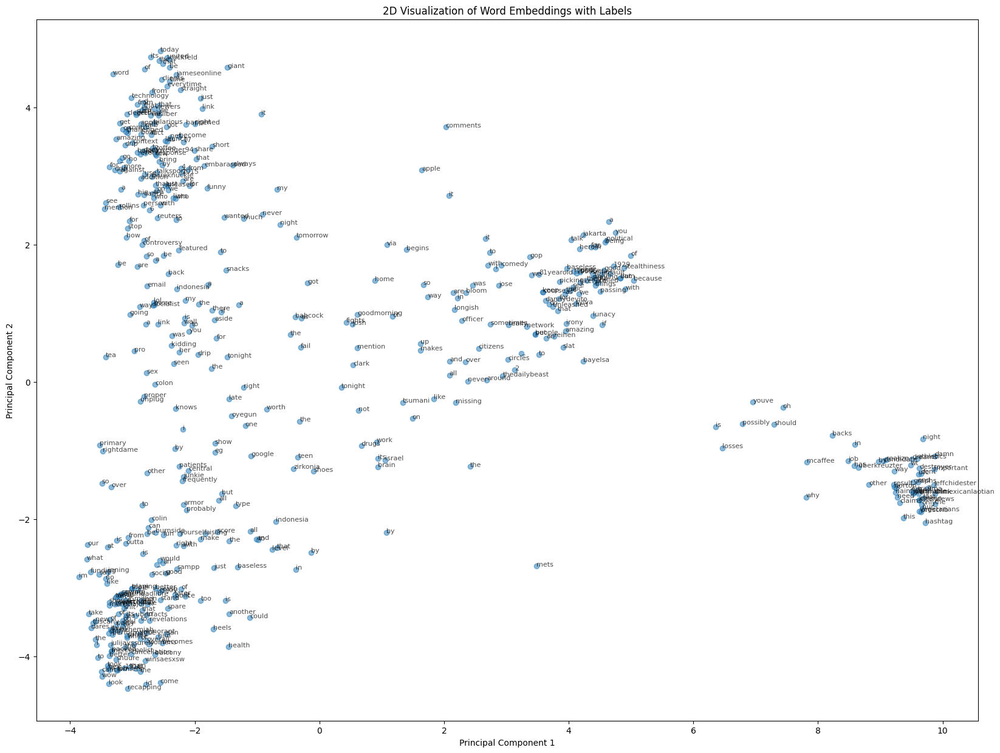

In [ ]:

# Load the word embeddings
embeddings = word_embeddings_subset

# Decode the tokenized input_ids back to words using the tokenizer
decoded_texts = [tokenizer.decode(input_id, skip_special_tokens=True) for input_id in input_ids_subset]

# Flatten the decoded texts to generate labels for each word embedding
flat_labels = ' '.join(decoded_texts).split()

# Limit the number of embeddings and labels for visualization
max_labels = 500
flat_word_embeddings = embeddings.reshape(-1, embeddings.shape[-1])
flat_word_embeddings = flat_word_embeddings[:max_labels]
flat_labels = flat_labels[:max_labels]

# Reduce the dimensionality of the flattened embeddings using PCA
pca = PCA(n_components=2)
embeddings_2d = pca.fit_transform(flat_word_embeddings)

# Plotting the embeddings with labels
plt.figure(figsize=(20, 15))
plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], alpha=0.5)

# Annotate each point with its corresponding word
for i, word in enumerate(flat_labels):
    plt.annotate(word, (embeddings_2d[i, 0], embeddings_2d[i, 1]), fontsize=8, alpha=0.7)

plt.title("2D Visualization of Word Embeddings with Labels")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.show()

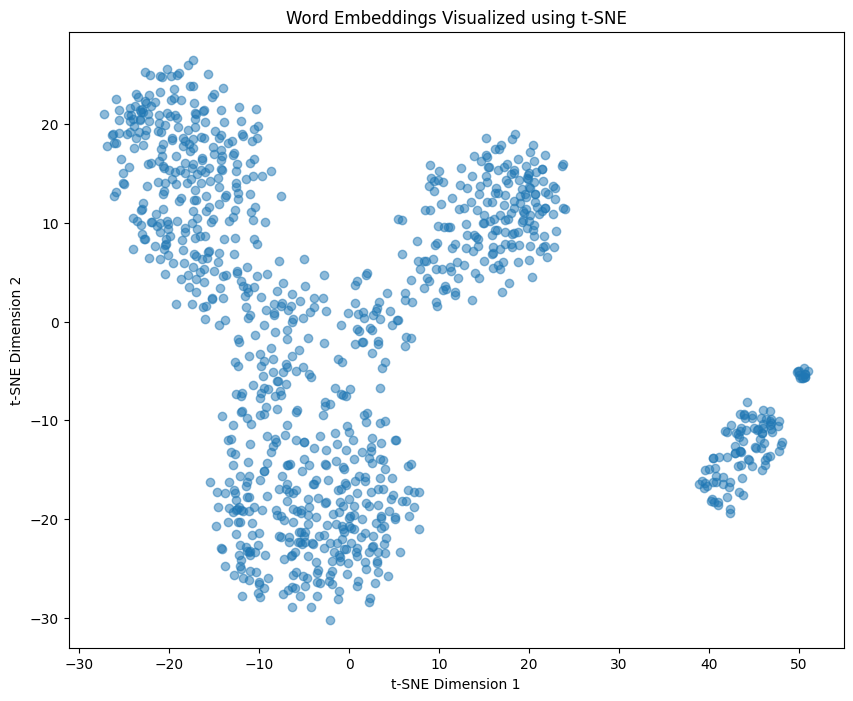

In [ ]:

# Reduce dimensionality using t-SNE
tsne = TSNE(n_components=2, random_state=42)
word_embeddings_tsne = tsne.fit_transform(word_embeddings_subset)

# Plotting the t-SNE reduced data
plt.figure(figsize=(10, 8))
plt.scatter(word_embeddings_tsne[:, 0], word_embeddings_tsne[:, 1], alpha=0.5)
plt.title('Word Embeddings Visualized using t-SNE')
plt.xlabel('t-SNE Dimension 1')
plt.ylabel('t-SNE Dimension 2')
plt.show()

In [ ]:
merged_data.to_csv('merged_data.csv')

',tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product,context,tweets,class,all_text\n0,,,No emotion toward brand or product,general,You\'ve blessed my dreams for 4 years and yet you\'re the reason I lye awake unable to do so #irony,irony, youve blessed my dreams for 4 years and yet youre the reason i lye awake unable to do so \n1,,,No emotion toward brand or product,general,I see a fun time was had by all (again!) at carnival this year #sarcasm,sarcasm, i see a fun time was had by all again at carnival this year \n2,@mention #webmobile talking about #mVideo. Talked about iPhone and Android video but what about the other 85% of phones? #SXSW,,No emotion toward brand or product,product,,regular,mention  talking about  talked about iphone and android video but what about the other 85 of phones  \n3,,,No emotion toward brand or product,general,I absolutely love when I spend 2 hours on a song and it doesn\'t save. #sarcasm,sarcasm, i absolutely love

In [ ]:
# Load the embeddings and dataset
embeddings = np.load('word_embeddings_subset.npy')
dataset = pd.read_csv('merged_data.csv', engine='python')

32/32 [==============================] - 43s 740ms/step


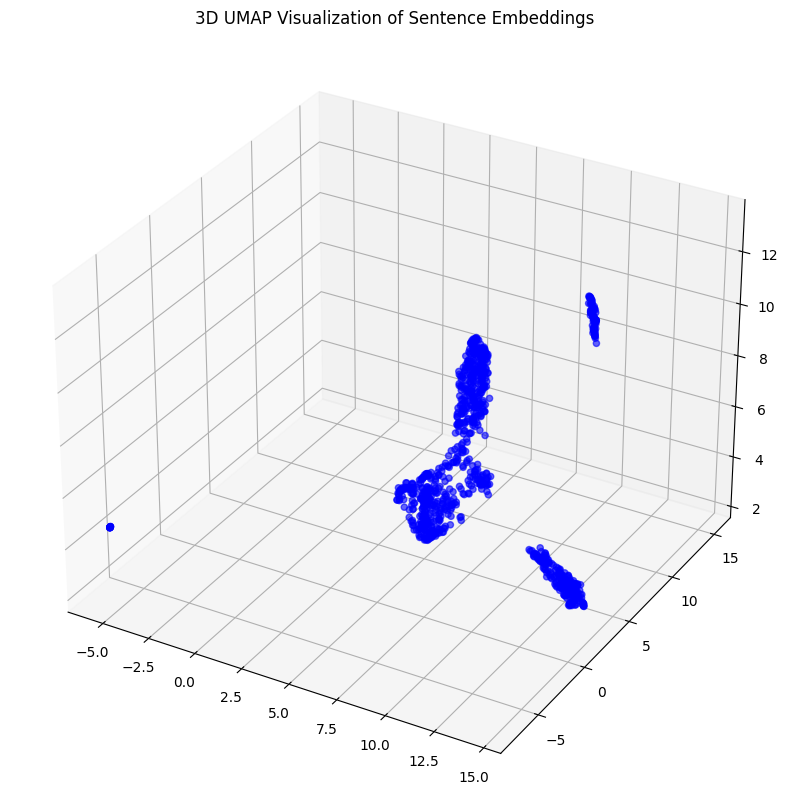

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.sequence import pad_sequences
from transformers import MobileBertTokenizer
import tensorflow as tf
import numpy as np
import pandas as pd
import umap
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


# Create a new model to extract sentence-level embeddings
sentence_embedding_layer = model.get_layer(name='bidirectional').output
sentence_embedding_model = Model(inputs=model.input, outputs=sentence_embedding_layer)

# Load dataset
merged_data = pd.read_csv('merged_data.csv', engine='python')

# Sample a subset of the data
subset_size = 1000
subset = merged_data.sample(subset_size)

# Tokenize and preprocess the subset
input_ids_subset = [tokenizer.encode(text, add_special_tokens=True, max_length=512, truncation=True) for text in subset['all_text']]
attention_masks_subset = [[1] * len(input_id) for input_id in input_ids_subset]
input_ids_subset = pad_sequences(input_ids_subset, maxlen=512, dtype='int32', padding='post', truncating='post', value=0)
attention_masks_subset = pad_sequences(attention_masks_subset, maxlen=512, dtype='int32', padding='post', truncating='post', value=0)

# Convert input data to TensorFlow tensors
input_ids_subset = tf.constant(input_ids_subset)
attention_masks_subset = tf.constant(attention_masks_subset)

# Generate sentence-level embeddings for the subset
sentence_embeddings_subset = sentence_embedding_model.predict([input_ids_subset, attention_masks_subset])

# UMAP transformation
reducer = umap.UMAP(n_components=3, random_state=42)
embeddings_3d_umap = reducer.fit_transform(sentence_embeddings_subset)

# Visualization
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(embeddings_3d_umap[:, 0], embeddings_3d_umap[:, 1], embeddings_3d_umap[:, 2], c='b', alpha=0.6)
ax.set_title("3D UMAP Visualization of Sentence Embeddings")
plt.show()

In [ ]:
import plotly.express as px
import pandas as pd

# Convert the UMAP embeddings to a DataFrame
df_umap = pd.DataFrame(embeddings_3d_umap, columns=['UMAP_X', 'UMAP_Y', 'UMAP_Z'])
df_umap['sentence'] = subset['all_text'].values
df_umap['label'] = subset['class'].values  # Assuming 'class' column contains labels like sarcasm, irony, etc.

# Create an interactive 3D scatter plot using Plotly with color-coded categories
fig = px.scatter_3d(df_umap, x='UMAP_X', y='UMAP_Y', z='UMAP_Z', color='label', hover_name='sentence', opacity=0.5)
fig.update_traces(marker=dict(size=5))
fig.update_layout(title="3D UMAP Visualization of Sentence Embeddings with Labels")
fig.show()

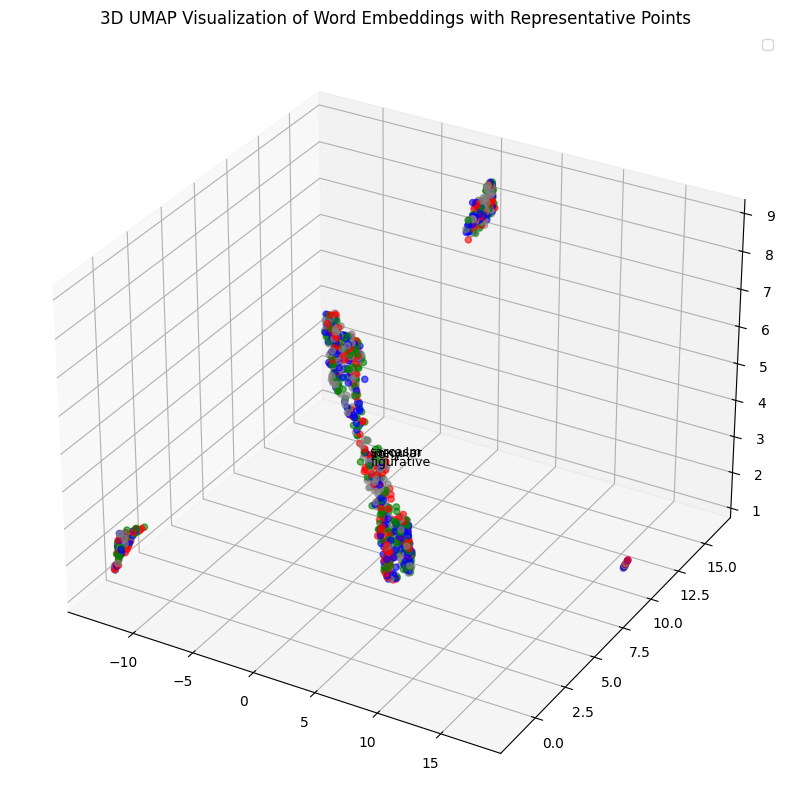

In [ ]:
class_labels = dataset['class'].values[:embeddings.shape[0]]

# Define color mapping for the classes
colors_map = {
    'sarcasm': 'red',
    'irony': 'blue',
    'figurative': 'green',
    'regular': 'grey'
}
colors = [colors_map.get(label) for label in class_labels]

# Flatten the embeddings for visualization
flat_word_embeddings = embeddings.reshape(-1, embeddings.shape[-1])

# UMAP dimensionality reduction to 3D
reducer = umap.UMAP(n_components=3, random_state=42)
embeddings_3d_umap = reducer.fit_transform(flat_word_embeddings)

# Calculate centroids for each class and identify representative points
representative_indices = {}
for label, color in colors_map.items():
    class_points = embeddings_3d_umap[class_labels == label]
    centroid = np.mean(class_points, axis=0)
    closest_index = np.argmin(np.linalg.norm(class_points - centroid, axis=1))
    representative_indices[label] = np.where(class_labels == label)[0][closest_index]

# 3D scatter plot with annotations for representative points
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(embeddings_3d_umap[:, 0], embeddings_3d_umap[:, 1], embeddings_3d_umap[:, 2], c=colors, alpha=0.6)

# Annotate representative points
for label, index in representative_indices.items():
    ax.text(embeddings_3d_umap[index, 0], embeddings_3d_umap[index, 1], embeddings_3d_umap[index, 2], label, fontsize=9)

ax.set_title("3D UMAP Visualization of Word Embeddings with Representative Points")
plt.legend(handles=scatter.legend_elements()[0], labels=colors_map.keys())
plt.show()


In [ ]:
import plotly.express as px


class_labels = dataset['class'].values[:embeddings.shape[0]]

# Flatten the embeddings for visualization
flat_word_embeddings = embeddings.reshape(-1, embeddings.shape[-1])

# UMAP dimensionality reduction to 3D
reducer = umap.UMAP(n_components=3, random_state=42)
embeddings_3d_umap = reducer.fit_transform(flat_word_embeddings)

# Convert the 3D embeddings and labels to a DataFrame
df = pd.DataFrame(embeddings_3d_umap, columns=['x', 'y', 'z'])
df['label'] = class_labels

# Create an interactive 3D scatter plot
fig = px.scatter_3d(df, x='x', y='y', z='z', color='label', title="3D UMAP Visualization of Word Embeddings",
                    color_discrete_map={
                        'sarcasm': 'red',
                        'irony': 'blue',
                        'figurative': 'green',
                        'regular': 'grey'
                    })

# Display the interactive plot
fig.show()


Initial Observations:

1. Distinct Clusters: There are clear clusters visible, especially for the "regular" class. This suggests that the embeddings effectively capture patterns specific to regular content.
2. Overlap & Distribution: There's overlap between "irony" and "sarcasm" classes, indicating shared features or nuances in the embedding space.
3. Dense & Sparse Regions: We can observe dense regions, suggesting common expressions or patterns, and sparse points, which might represent unique or nuanced expressions.
4. Depth Perspective: The third dimension (UMAP_Z) adds depth to the visualization, allowing for better separation and understanding of clusters that might overlap in 2D.

# BiLSTM

In [ ]:
from tensorflow.keras.layers import Embedding
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dropout, Dense, Bidirectional, LSTM, Embedding
from tensorflow.keras.optimizers.schedules import ExponentialDecay
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import numpy as np

# Assuming vocabulary size and embedding dimension
VOCAB_SIZE = 30522  # Adjust based on your tokenizer's vocabulary or input features
EMBEDDING_DIM = 128

# Define the inputs
input_ids = Input(shape=(512,), dtype='int32')

# Embedding layer
embedding_layer = Embedding(input_dim=VOCAB_SIZE, output_dim=EMBEDDING_DIM)(input_ids)

# Add a BiLSTM layer
lstm_output = Bidirectional(LSTM(128, return_sequences=False))(embedding_layer)

# Add dropout for regularization
lstm_output = Dropout(0.1)(lstm_output)

# Add a Dense layer for each classification task
context_output = Dense(len(le_context.classes_), activation='softmax', name='context_output')(lstm_output)
class_output = Dense(len(le_class.classes_), activation='softmax', name='class_output')(lstm_output)

# Define the model
bilstm_model = Model(inputs=input_ids, outputs=[context_output, class_output])

# Compile the model
bilstm_model.compile(
    loss={'context_output': 'sparse_categorical_crossentropy', 'class_output': 'sparse_categorical_crossentropy'},
    metrics={'context_output': 'accuracy', 'class_output': 'accuracy'}
)

In [ ]:
# Convert the targets to numpy arrays
train_context = np.array(train_context)
validation_context = np.array(validation_context)
train_class = np.array(train_class)
validation_class = np.array(validation_class)

# Train the BiLSTM-only model
history_bilstm = bilstm_model.fit(
    train_inputs,  # No need for masks since we're not using BERT
    [train_context, train_class],
    validation_data=(validation_inputs, [validation_context, validation_class]),
    batch_size=30,
    epochs=3
)

Epoch 1/3
2715/2715 [==============================] - 1114s 410ms/step - loss: 1.1471 - context_output_loss: 0.0477 - class_output_loss: 1.0994 - context_output_accuracy: 0.9857 - class_output_accuracy: 0.4897 - val_loss: 1.0835 - val_context_output_loss: 0.0310 - val_class_output_loss: 1.0525 - val_context_output_accuracy: 0.9908 - val_class_output_accuracy: 0.5180
Epoch 2/3
2715/2715 [==============================] - 1059s 390ms/step - loss: 1.0241 - context_output_loss: 0.0275 - class_output_loss: 0.9965 - context_output_accuracy: 0.9921 - class_output_accuracy: 0.5492 - val_loss: 1.0806 - val_context_output_loss: 0.0464 - val_class_output_loss: 1.0342 - val_context_output_accuracy: 0.9834 - val_class_output_accuracy: 0.5298
Epoch 3/3
2715/2715 [==============================] - 1085s 400ms/step - loss: 0.9655 - context_output_loss: 0.0226 - class_output_loss: 0.9428 - context_output_accuracy: 0.9937 - class_output_accuracy: 0.5760 - val_loss: 1.0449 - val_context_output_loss: 0.0